### INFO 623 Social Network Analytics
### Project : Social Network Analytics on Facebook Users
### Team: 
###            1. Karthikreddy Kuna (KK3375)
###            2. Pradeep Kankipati(PK593)

In [103]:
## Imports all necessary modules
import networkx as nx
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
from networkx import community
from networkx.algorithms.community import greedy_modularity_communities
import random
import math
import csv
from sklearn import svm
from sklearn.metrics import accuracy_score , f1_score
from sklearn.preprocessing import normalize
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler 

##### Generate the Facebook social network.

In [2]:
G_fbsocial = nx.read_edgelist("facebook_combined.txt", create_using = nx.Graph(), nodetype=int)

In [3]:
print(nx.info(G_fbsocial))

Name: 
Type: Graph
Number of nodes: 4039
Number of edges: 88234
Average degree:  43.6910


In [4]:
print("Number of Actors:", nx.number_of_nodes(G_fbsocial),'\n')
print("Number of Ties:", nx.number_of_edges(G_fbsocial),'\n')
print("Diameter:", nx.diameter(G_fbsocial),'\n')
print("Average Clustering:", nx.average_clustering(G_fbsocial),'\n')
print("Network Density:", nx.density(G_fbsocial), '\n')
print("Connected Graph:", nx.is_connected(G_fbsocial))

Number of Actors: 4039 

Number of Ties: 88234 

Diameter: 8 

Average Clustering: 0.6055467186200876 

Network Density: 0.010819963503439287 

Connected Graph: True


In [5]:
def plt_network(G):
    pos = nx.spring_layout(G)
    plt.style.use('fivethirtyeight')
    plt.rcParams['figure.figsize'] = (30, 25)
    plt.axis('off')
    nx.draw_networkx(G, pos, with_labels = False, node_size = 30, node_color='r')
    plt.show()

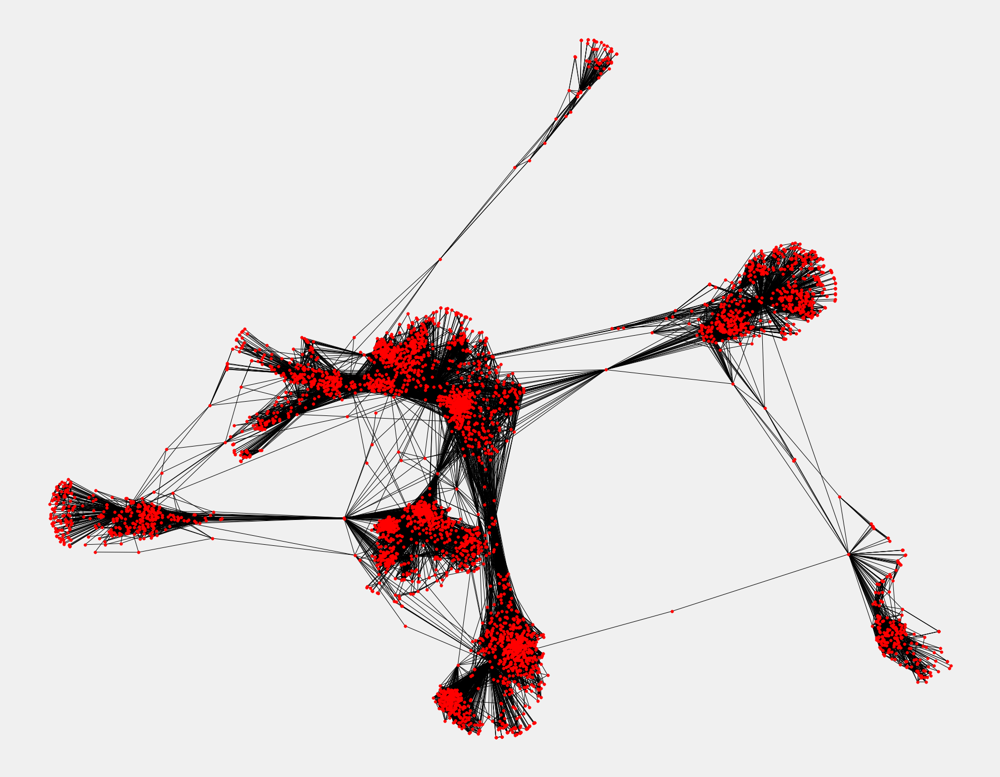

In [6]:
plt_network(G_fbsocial)

Let's create a subgraph with minimum degree 50.

In [7]:
node_degree_dict=nx.degree(G_fbsocial)
G_temp=nx.subgraph(G_fbsocial,[x for x in G_fbsocial.nodes() if node_degree_dict[x]>50])
G_subgraph_fb = nx.Graph(G_temp)
G_subgraph_fb.remove_nodes_from(list(nx.isolates(G_subgraph_fb)))

In [8]:
print(nx.info(G_subgraph_fb))

Name: 
Type: Graph
Number of nodes: 1143
Number of edges: 50324
Average degree:  88.0560


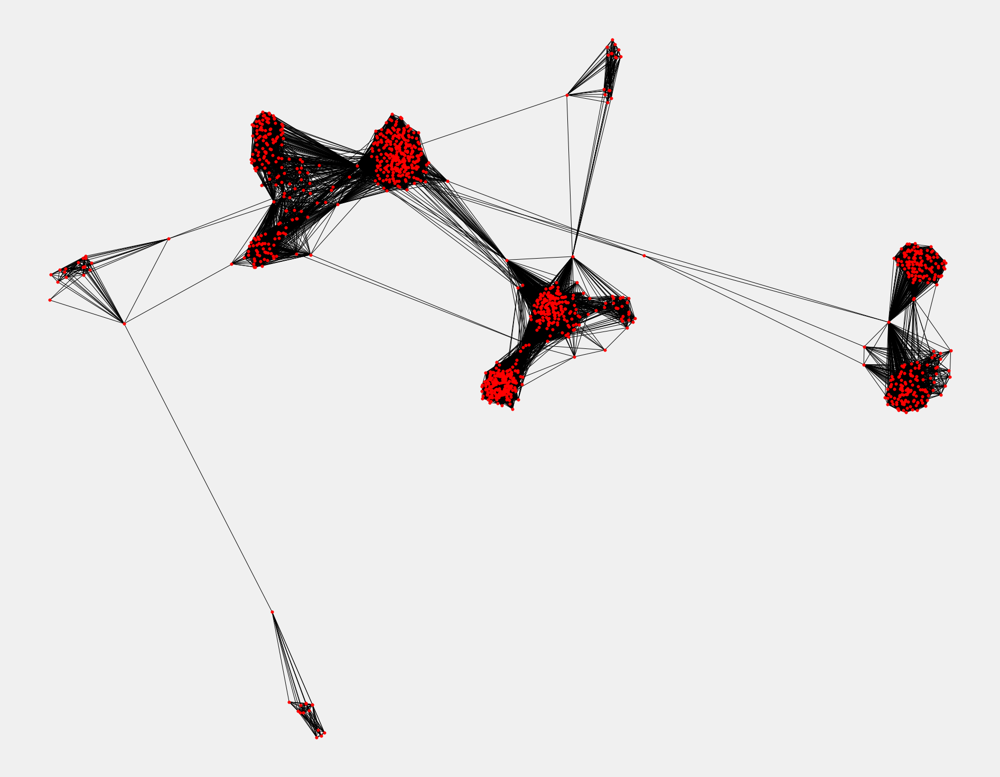

In [9]:
plt_network(G_subgraph_fb)

In [10]:
###Define function to plot the centrality
def plt_network_centrality(G, central_measure, central_list):
    labels = {} 
    for node in G.nodes():
        if node in central_list:
            labels[node] = node
    pos = nx.spring_layout(G)
    node_color = [20000.0 * G.degree(v) for v in G]
    node_size =  [v * 10000 for v in central_measure.values()]
    plt.style.use('fivethirtyeight')
    plt.rcParams['figure.figsize'] = (30, 25)
    nx.draw_networkx(G, pos=pos, with_labels=False,
                     node_color=node_color,
                     node_size=node_size )
    nx.draw_networkx_labels(G,pos,labels,font_size=35,font_color='r')
    plt.axis('off')

### Centrality

#### Lets find the actor(s) with the highest degree centrality <br />
The degree of a actor is defined as number of connecting ties particular actor has with others. To calculate Degree centrality of a actor, the degree of a actor is divided by number of other actors in the network(n-1). 

Degree centrality metric defines importance of a actor in a network as being measured based on its degree i.e the higher the degree of a actor, the more important it is in a network.

###### G_fbsocial_degree centrality

In [11]:
degree_central = nx.degree_centrality(G_fbsocial)
top_degree_central = sorted(degree_central, key=degree_central.get, reverse=True)[:5]
print("Top 5 degree centrality nodes:", top_degree_central)

Top 5 degree centrality nodes: [107, 1684, 1912, 3437, 0]


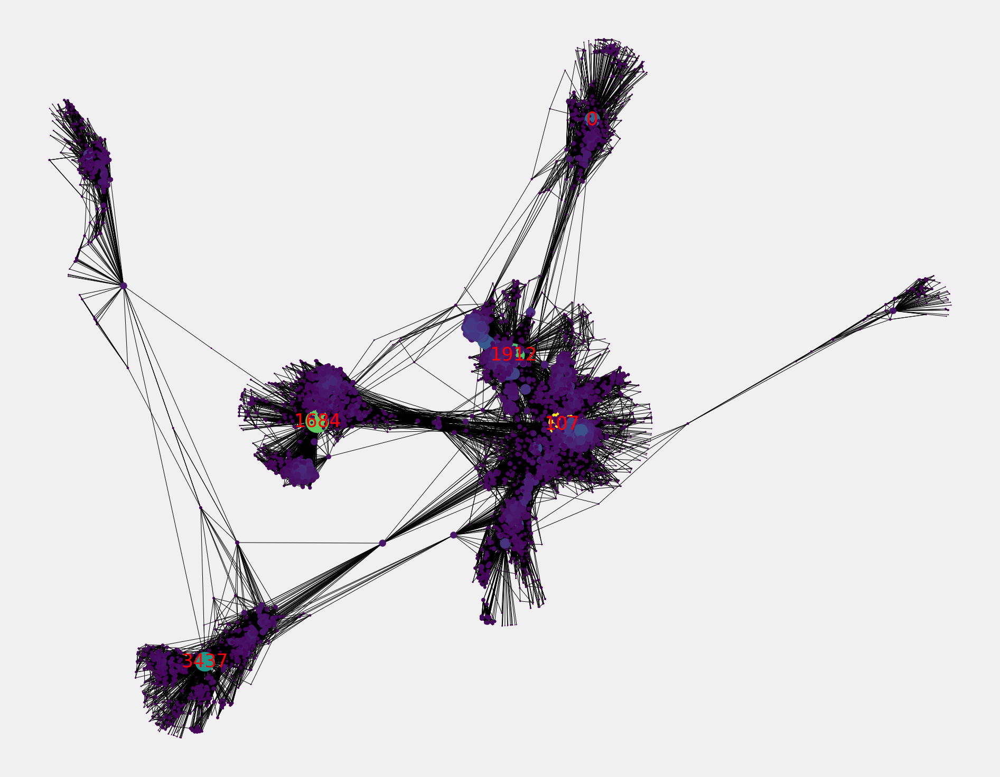

In [12]:
plt_network_centrality(G_fbsocial,degree_central, top_degree_central)

In [13]:
G_fbsocial.degree(107)

1045

In [14]:
G_fbsocial.degree(1684)

792

In [15]:
G_fbsocial.degree(1912)

755

In [16]:
G_fbsocial.degree(3437)

547

In [17]:
G_fbsocial.degree(0)

347

###### G_subgraph_fb_degree centrality

In [18]:
degree_central_sub = nx.degree_centrality(G_subgraph_fb)
top_degree_central_sub = sorted(degree_central_sub, key=degree_central_sub.get, reverse=True)[:5]
print("Top 5 degree centrality nodes:", top_degree_central_sub)

Top 5 degree centrality nodes: [107, 1912, 2347, 2543, 1684]


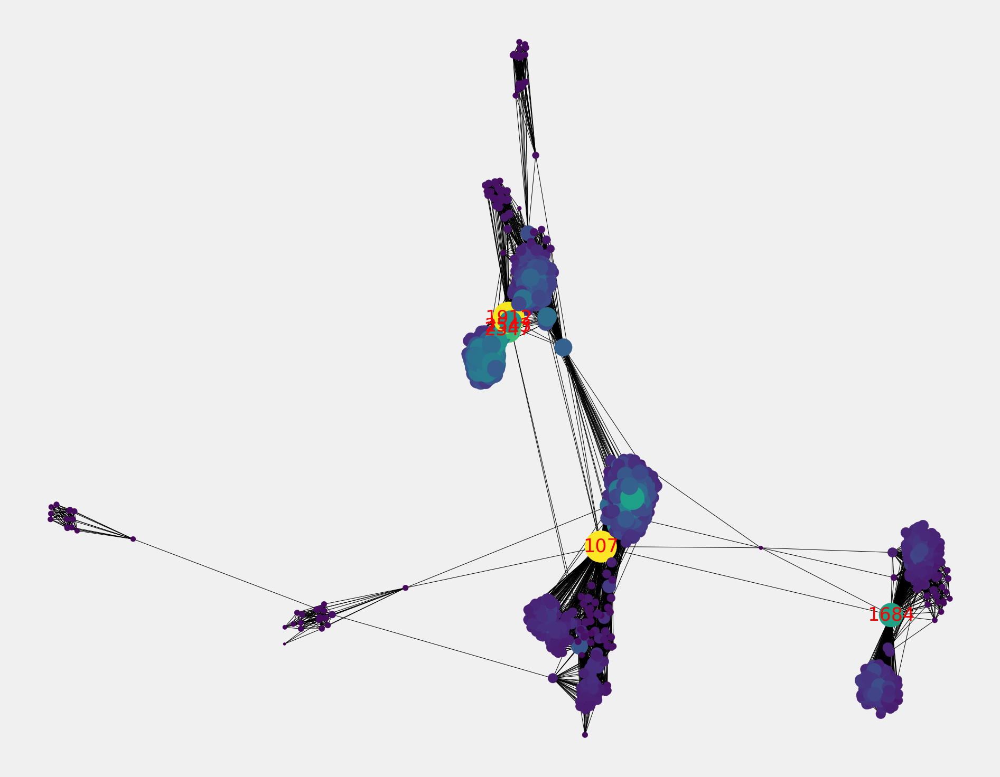

In [19]:
plt_network_centrality(G_subgraph_fb,degree_central_sub, top_degree_central_sub)

#### Lets find the actor(s) with the highest closeness centrality <br />
Closeness centrality metric defines the importance of a actor in a network as being measured by how close it is to all other actors in the network.For a actor, it is defined as the average of the geodesic distance between that actor to all other actors in the network.

###### G_fbsocial Closeness centrality

In [20]:
close_central = nx.closeness_centrality(G_fbsocial)
top_close_central = sorted(close_central, key=close_central.get, reverse=True)[:5]
print("Top 5 closeness centrality nodes:", top_close_central)

Top 5 closeness centrality nodes: [107, 58, 428, 563, 1684]


In [21]:
closeness_centrality = sorted(close_central.items(), key = lambda i:(i[1], i[0]), reverse = True)[:5]
closeness_centrality

[(107, 0.45969945355191255),
 (58, 0.3974018305284913),
 (428, 0.3948371956585509),
 (563, 0.3939127889961955),
 (1684, 0.39360561458231796)]

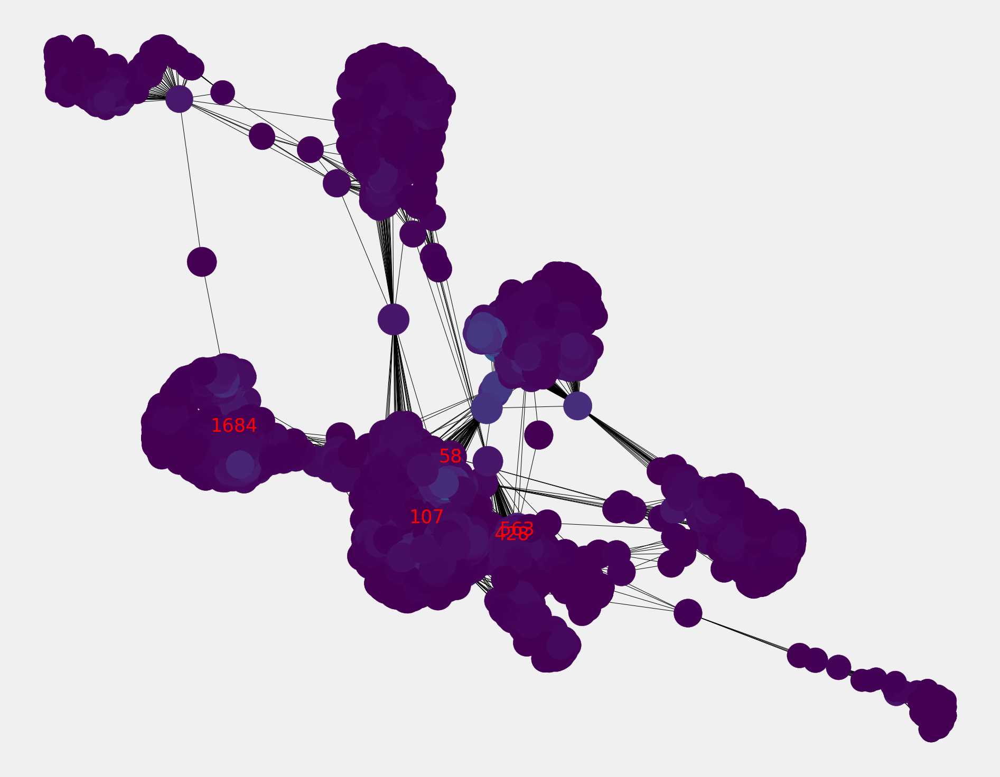

In [22]:
plt_network_centrality(G_fbsocial,close_central, top_close_central)

In [23]:
short_path = nx.single_source_shortest_path_length(G_fbsocial, source = 107)
k = sum(short_path.values())
print("Sum of geodesic distance from '107' is:",k)

Sum of geodesic distance from '107' is: 8784


In [24]:
short_path = nx.single_source_shortest_path_length(G_fbsocial, source = 58)
k = sum(short_path.values())
print("Sum of geodesic distance from '58' is:",k)

Sum of geodesic distance from '58' is: 10161


In [25]:
short_path = nx.single_source_shortest_path_length(G_fbsocial, source = 428)
k = sum(short_path.values())
print("Sum of geodesic distance from '428' is:",k)

Sum of geodesic distance from '428' is: 10227


In [26]:
short_path = nx.single_source_shortest_path_length(G_fbsocial, source = 563)
k = sum(short_path.values())
print("Sum of geodesic distance from '563' is:",k)

Sum of geodesic distance from '563' is: 10251


In [27]:
short_path = nx.single_source_shortest_path_length(G_fbsocial, source = 1684)
k = sum(short_path.values())
print("Sum of geodesic distance from '1684' is:",k)

Sum of geodesic distance from '1684' is: 10259


###### G_subgraph_fb Closeness centrality

In [28]:
close_central_sub = nx.closeness_centrality(G_subgraph_fb)
top_close_central_sub = sorted(close_central_sub, key=close_central_sub.get, reverse=True)[:5]
print("Top 5 closeness centrality nodes:", top_close_central_sub)

Top 5 closeness centrality nodes: [107, 1577, 1718, 428, 1465]


In [119]:
closeness_centrality_sub = sorted(close_central_sub.items(), key = lambda i:(i[1], i[0]), reverse = True)[:5]
closeness_centrality_sub

[(107, 0.5282146160962072),
 (1577, 0.45716573258606885),
 (1718, 0.45425616547334924),
 (428, 0.4519192718638702),
 (1465, 0.4476675813406507)]

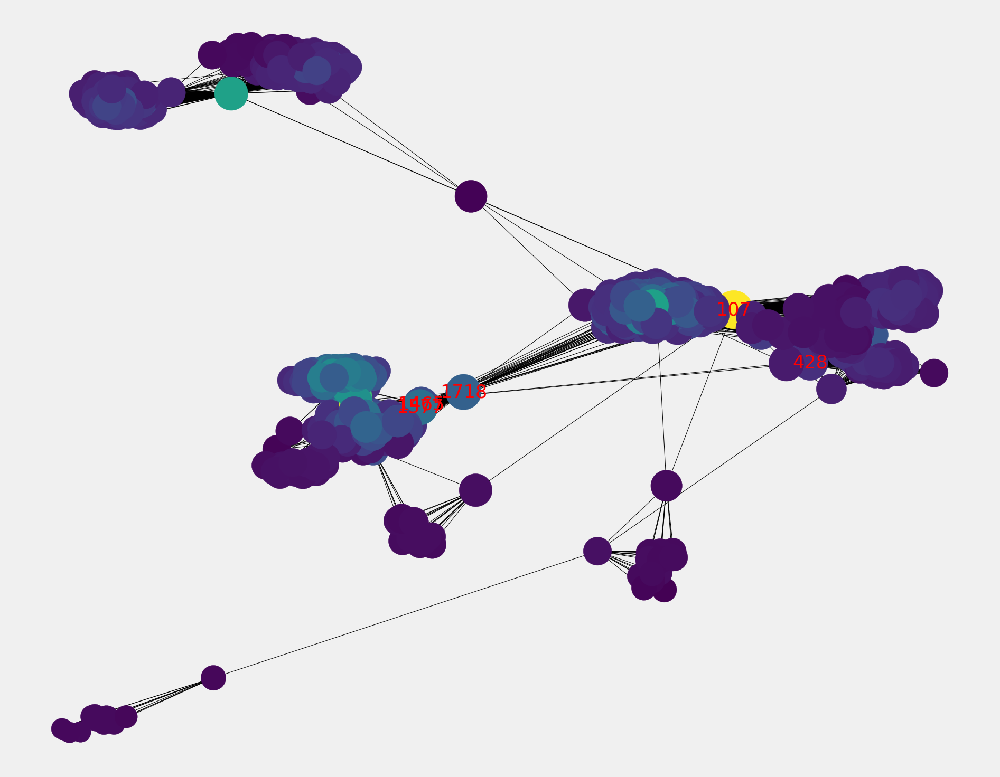

In [29]:
plt_network_centrality(G_subgraph_fb,close_central_sub, top_close_central_sub)

##### Lets find the actor(s) with the highest betweeness centrality  <br />
Betweeness centrality metric defines and measures the importance of a actor in a network based upon how many times it occurs in the shortest path between all pair of actors in the network. The actor with highest betweenness centrality acts like a bridge between two social groups.

###### G_fbsocial Betweeness centrality

In [30]:
between_central = nx.betweenness_centrality(G_fbsocial, normalized=True, endpoints=True)
top_between_central = sorted(between_central, key=between_central.get, reverse=True)[:5]
print("Top 5 betweeness centrality nodes:", top_between_central)

Top 5 betweeness centrality nodes: [107, 1684, 3437, 1912, 1085]


In [31]:
betweenness_centrality = sorted(between_central.items(), key = lambda i:(i[1], i[0]), reverse = True)[:5]
betweenness_centrality

[(107, 0.48077531149557645),
 (1684, 0.33812535393929544),
 (3437, 0.23649361170042005),
 (1912, 0.22967697101070242),
 (1085, 0.14943647607698152)]

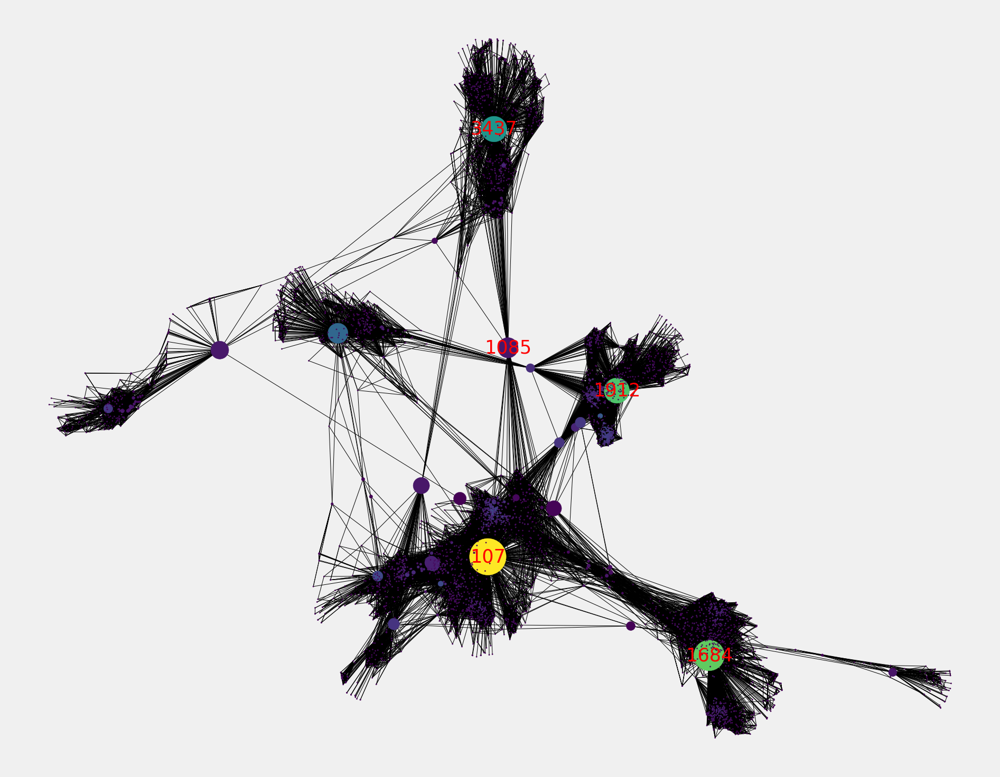

In [32]:
plt_network_centrality(G_fbsocial,between_central, top_between_central )

###### G_subgraph_fb Betweeness centrality

In [33]:
between_central_sub = nx.betweenness_centrality(G_subgraph_fb, normalized=True, endpoints=True)
top_between_central_sub = sorted(between_central_sub, key=between_central_sub.get, reverse=True)[:5]
print("Top 5 betweeness centrality nodes:", top_between_central_sub)

Top 5 betweeness centrality nodes: [107, 1684, 1912, 1718, 1577]


In [118]:
betweenness_centrality_sub = sorted(between_central_sub.items(), key = lambda i:(i[1], i[0]), reverse = True)[:5]
betweenness_centrality_sub

[(107, 0.5530400036447516),
 (1684, 0.346713961884091),
 (1912, 0.1867928883663688),
 (1718, 0.13945898618781966),
 (1577, 0.12701324126479357)]

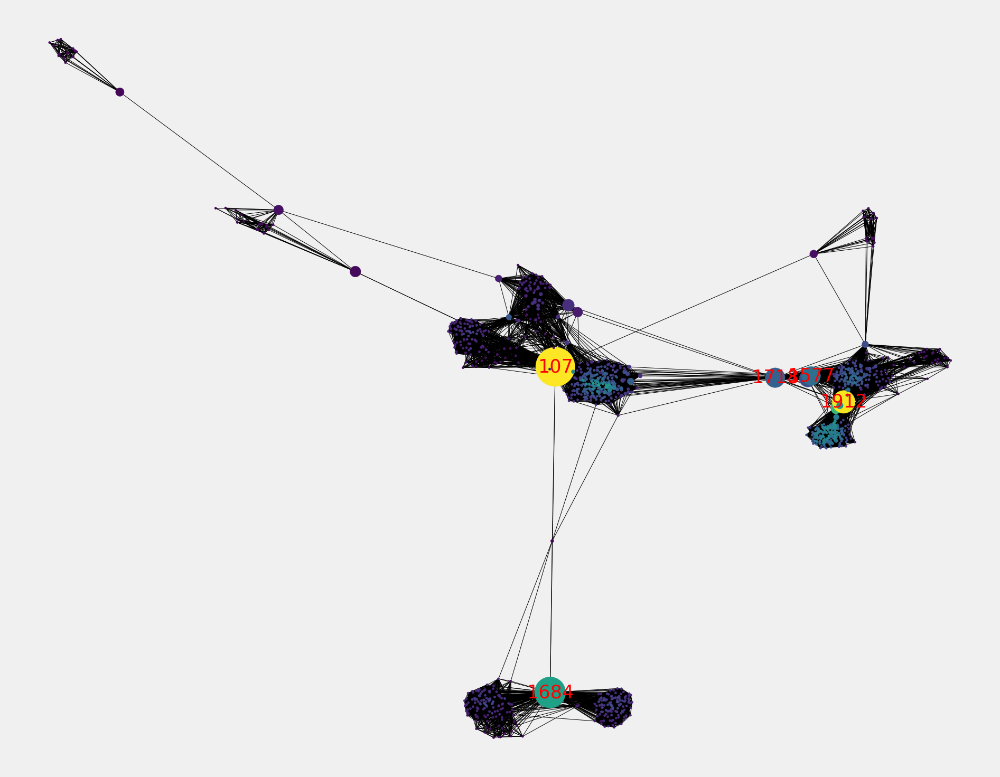

In [34]:
plt_network_centrality(G_subgraph_fb,between_central_sub, top_between_central_sub)

##### Lets find the actor(s) with the highest eigenvector centrality  <br />
Eigenvector centrality is a measure of the influence of a actor in a network. It assigns relative scores to all actors in the network based on the concept that connections to high-scoring actors contribute more to the score of the actor in question than equal connections to low-scoring actors.

###### G_fbsocial Eigenvector centrality

In [35]:
eigen_central = nx.eigenvector_centrality(G_fbsocial)
top_eigen_central = sorted(eigen_central, key=eigen_central.get, reverse=True)[:5]
print("Top 5 eigenvector centrality nodes:", top_eigen_central)

Top 5 eigenvector centrality nodes: [1912, 2266, 2206, 2233, 2464]


In [36]:
eigen_centrality = sorted(eigen_central.items(), key = lambda i:(i[1], i[0]), reverse = True)[:5]
eigen_centrality

[(1912, 0.09540696149067629),
 (2266, 0.08698327767886553),
 (2206, 0.08605239270584343),
 (2233, 0.08517340912756598),
 (2464, 0.08427877475676092)]

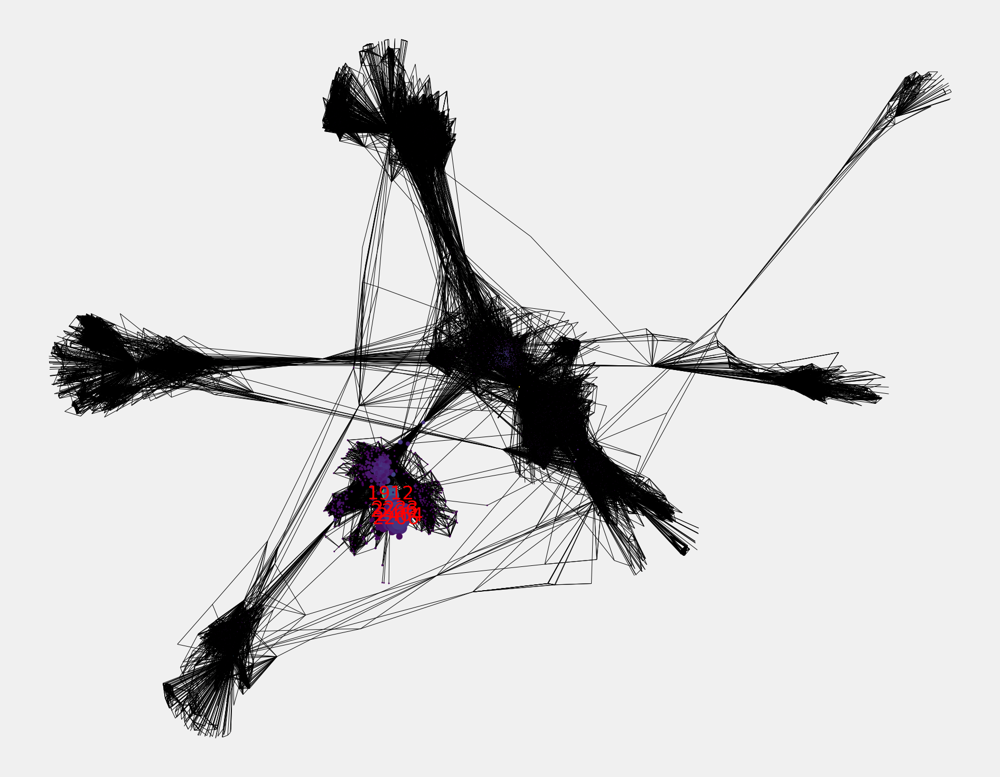

In [37]:
plt_network_centrality(G_fbsocial,eigen_central, top_eigen_central)

###### G_subgraph_fb Eigenvector centrality

In [38]:
eigen_central_sub = nx.eigenvector_centrality(G_subgraph_fb)
top_eigen_central_sub = sorted(eigen_central_sub, key=eigen_central_sub.get, reverse=True)[:5]
print("Top 5 eigenvector centrality nodes:", top_eigen_central_sub)

Top 5 eigenvector centrality nodes: [1912, 2266, 2206, 2233, 2464]


In [120]:
eigen_centrality_sub = sorted(eigen_central_sub.items(), key = lambda i:(i[1], i[0]), reverse = True)[:5]
eigen_centrality_sub

[(1912, 0.09209797568781998),
 (2266, 0.08634034441692785),
 (2206, 0.08624255422568931),
 (2233, 0.08518486431929224),
 (2464, 0.08461774213989234)]

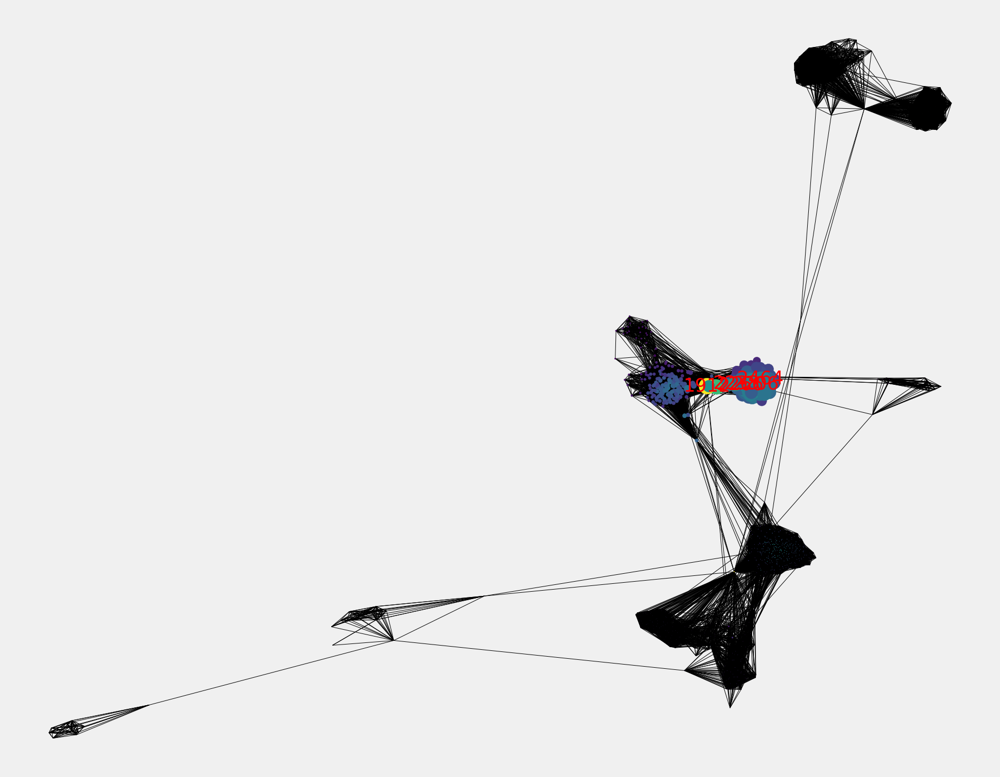

In [39]:
plt_network_centrality(G_subgraph_fb,eigen_central_sub, top_eigen_central_sub)

### Community Detection

###### Let's create function to generate subgraph based on user and funtion to plot the graph

In [40]:
def create_subgraph(G, user):
    first_degree_connected_nodes = list(G.neighbors(user))
    second_degree_connected_nodes = []
    for x in first_degree_connected_nodes:
        second_degree_connected_nodes+=list(G.neighbors(x))
    second_degree_connected_nodes.remove(user)
    second_degree_connected_nodes = list(set(second_degree_connected_nodes))

    subgraph_user = nx.subgraph(G,first_degree_connected_nodes+second_degree_connected_nodes,)
    return subgraph_user

In [41]:
def plot_subgraph(G, node):
    pos = nx.spring_layout(G)
    node_color = ['yellow' if v == node else 'red' for v in G]
    node_size =  [1000 if v == node else 35 for v in G]
    plt.style.use('fivethirtyeight')
    plt.rcParams['figure.figsize'] = (30, 25)
    plt.axis('off')

    nx.draw_networkx(G, pos, with_labels = False, node_color=node_color,node_size=node_size )
    plt.show()

###### Girvan newman Algorithm 

In [42]:
def edge_to_remove(G):
  G_edge_dict = nx.edge_betweenness_centrality(G)
  edge = ()

  # extract the edge with highest edge betweenness centrality score
  for key, value in sorted(G_edge_dict.items(), key=lambda item: item[1], reverse = True):
      edge = key
      break

  return edge

In [43]:
def girvan_newman(G, comm_num):
    # find number of connected components
    connect = nx.connected_components(G)
    connect_count = nx.number_connected_components(G)
   
    while(connect_count <= (comm_num - 1)):
        G.remove_edge(edge_to_remove(G)[0], edge_to_remove(G)[1])
        connect = nx.connected_components(G)
        connect_count = nx.number_connected_components(G)
        if nx.number_of_edges(G) < 100:
            connect_count = comm_num
    return connect , G

In [44]:
def community_node(G, comm_num = 2):
    # find communities in the graph
    modularity = []
    node_groups = []
    communities ,graph = girvan_newman(G.copy(), comm_num)
    original_graph = G.copy()
    m = original_graph.number_of_edges()
    q = 0 
    for group in communities:
        node_groups.append(list(group))
        for nodei in group:
            for nodej in group:
                ki = original_graph.degree(nodei)
                kj = original_graph.degree(nodej)
                aij = 0
                if graph.has_edge(nodei, nodej) is True:
                    aij = 1
                else:
                    aij = 0
                q = aij - (ki*kj)/(m*2) +q
        q = q/(2*m)
        modularity.append(q)

    return graph , modularity, node_groups

In [45]:
def plot_community_subgraph(G, node_groups):   
    # plot the communities
    colors = ["green", "red", "orange", "blue", "violet", "cyan", "yellow", "indigo", "pink",  "black", "aliceblue", "aqua", "aquamarine", "darkturquoise", "royalblue"]
    plt.style.use('fivethirtyeight')
    plt.rcParams['figure.figsize'] = (30, 25)
    pos = nx.spring_layout(G)
    for i in range(len(node_groups)):
        graph = node_groups[i]
        node_list = [node for node in graph]
        nx.draw(G,  pos,with_labels = False, nodelist=node_list, node_color=colors[i%10], alpha = 0.8)
    plt.show()

### Community detection on G_fbsocial

###### G_fbsocial Girvan newman

In [75]:
graph_fb, modularity_fb, community_node_groups_fb = community_node(G_fbsocial, 2)

In [87]:
modularity_fb

[0.02175211307680976, 0.021967572832132853]

In [88]:
print("Modularity:", nx.algorithms.community.modularity(G_fbsocial, community_node_groups_fb))

Modularity: 0.04393489913676287


In [122]:
print(community_node_groups_fb)

[[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221

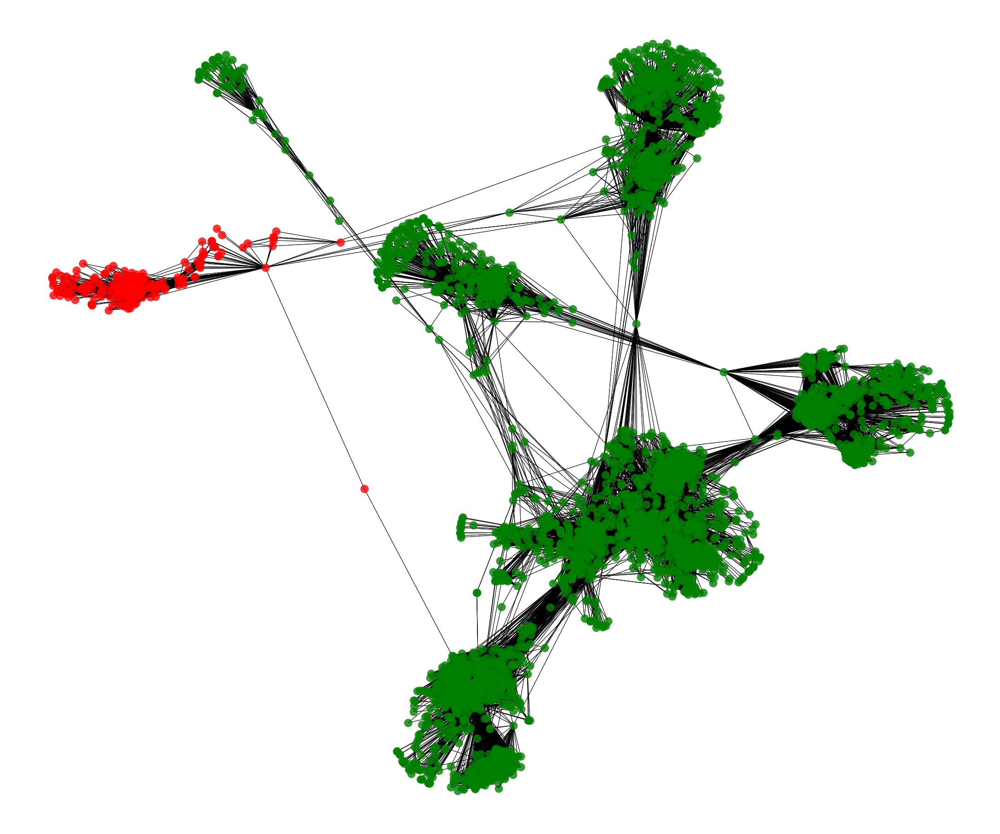

In [89]:
plot_community_subgraph(G_fbsocial, community_node_groups_fb)

###### G_fbsocial Greedy modularity

In [47]:
greed_community_fb = greedy_modularity_communities(G_fbsocial)
greed_list_fb = list(greed_community_fb)
print("number of communities is", len(list(greed_community_fb)))
print(greed_list_fb)

number of communities is 13
[frozenset({3261, 3271, 3277, 3280, 3281, 3282, 3291, 3292, 1290, 3330, 3335, 3336, 3337, 3338, 3350, 1317, 3354, 1321, 1323, 1325, 1327, 3368, 3373, 3376, 3378, 2661, 2662, 2665, 3379, 2667, 2668, 3380, 2671, 2672, 2674, 2675, 3381, 2677, 2678, 2975, 2682, 2684, 2685, 2686, 2687, 2688, 3383, 2690, 2691, 2692, 2693, 2696, 2697, 2700, 2701, 2702, 3038, 2707, 2708, 2709, 2711, 2712, 2713, 2714, 2715, 2716, 2718, 2719, 2720, 2721, 2722, 2723, 2724, 2725, 2727, 2728, 2730, 2732, 2733, 2734, 2735, 2736, 2737, 2739, 2742, 2744, 2747, 2748, 2751, 2752, 2753, 2758, 2759, 2760, 2762, 2764, 2765, 2768, 3122, 2770, 2771, 2772, 1365, 2775, 2776, 3401, 2778, 2779, 2780, 2781, 3402, 2783, 2784, 2785, 3403, 2787, 2788, 2790, 2791, 2792, 2793, 2795, 2796, 2797, 2799, 2801, 2802, 2803, 2804, 2805, 3407, 2808, 2811, 2812, 2813, 2816, 2818, 2819, 2820, 2822, 2823, 2824, 2825, 2826, 2828, 2829, 2830, 2831, 2832, 2833, 2836, 2840, 2841, 2842, 2843, 2844, 2845, 2846, 2847, 2848, 

In [48]:
print("Modularity:", nx.algorithms.community.modularity(G_fbsocial, greed_list_fb))

Modularity: 0.7773775199039185


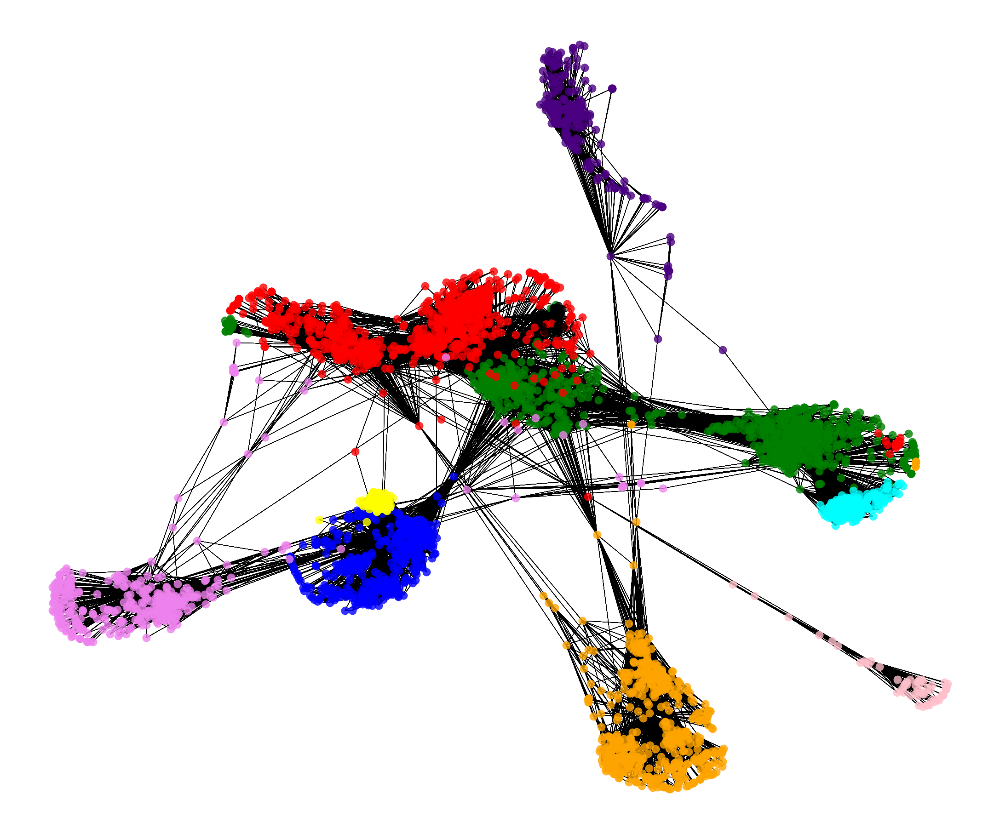

In [49]:
plot_community_subgraph(G_fbsocial, greed_list_fb)

### Community detection on G_subgraph_fb

###### G_subgraph_fb Girvan newman

In [ ]:
graph_subfb, modularity_subfb, community_node_groups_subfb = community_node(G_subgraph_fb, 5)

In [55]:
modularity_subfb

[0.00285275007096373,
 0.24946820707882778,
 0.23153836445572948,
 0.11348171106943142,
 0.0044912808798421395]

In [56]:
print("Modularity:", nx.algorithms.community.modularity(G_subgraph_fb, community_node_groups_subfb))

Modularity: 0.6019456060093185


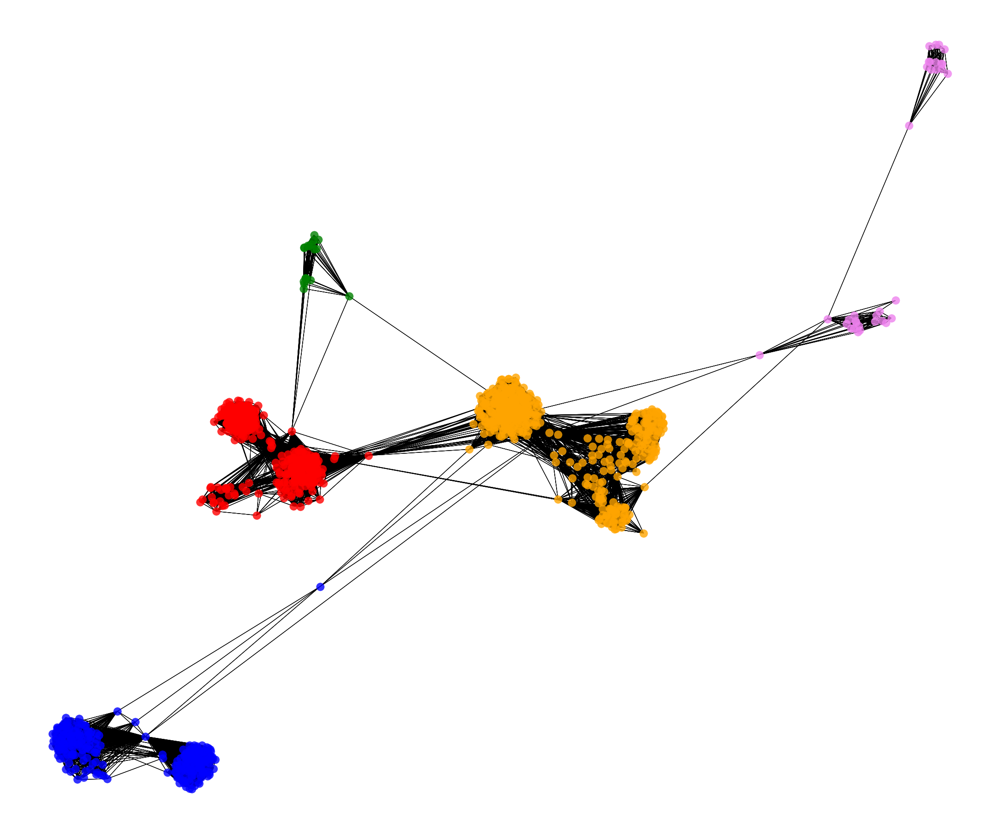

In [57]:
plot_community_subgraph(G_subgraph_fb, community_node_groups_subfb)

###### G_subgraph_fb Greedy modularity

In [58]:
greed_community_subfb = greedy_modularity_communities(G_subgraph_fb)
greed_list_subfb = list(greed_community_subfb)
print("number of communities is", len(list(greed_community_subfb)))
print(greed_list_subfb)

number of communities is 8
[frozenset({1024, 1026, 1538, 1028, 1029, 1539, 1542, 1547, 1551, 1040, 1554, 1557, 1047, 1048, 1049, 1559, 1563, 1054, 1056, 1570, 1059, 1571, 1580, 1584, 1074, 1075, 1076, 1589, 1078, 1079, 1590, 1083, 1597, 1598, 1600, 1603, 1604, 1605, 1608, 1609, 1610, 1612, 1101, 1613, 1614, 1617, 1107, 1619, 1620, 1110, 1621, 1112, 1622, 1623, 1117, 1632, 1123, 1124, 1125, 1126, 1637, 1128, 1639, 1130, 1643, 1132, 1644, 1135, 1652, 1653, 1146, 1659, 1149, 1662, 1663, 1153, 1665, 1156, 1668, 1669, 1160, 1163, 1675, 1683, 1172, 1173, 1685, 1175, 1688, 1689, 1181, 1182, 1184, 1185, 1191, 1707, 1198, 1199, 1712, 1201, 1714, 1205, 1717, 1207, 1209, 1721, 1211, 1722, 1724, 1214, 1730, 1219, 1222, 1735, 1736, 1737, 1741, 1230, 1746, 1238, 1750, 1752, 1753, 1242, 1243, 1754, 1757, 1761, 1250, 1765, 1255, 1256, 1768, 1772, 1267, 1269, 1782, 1271, 1272, 1789, 1791, 1280, 1793, 1795, 1796, 1285, 1799, 1800, 1287, 1288, 1289, 1804, 1290, 1291, 1809, 1810, 1811, 1813, 1302, 1816, 1

In [59]:
print("Modularity:", nx.algorithms.community.modularity(G_subgraph_fb, greed_list_subfb))

Modularity: 0.7364018612692158


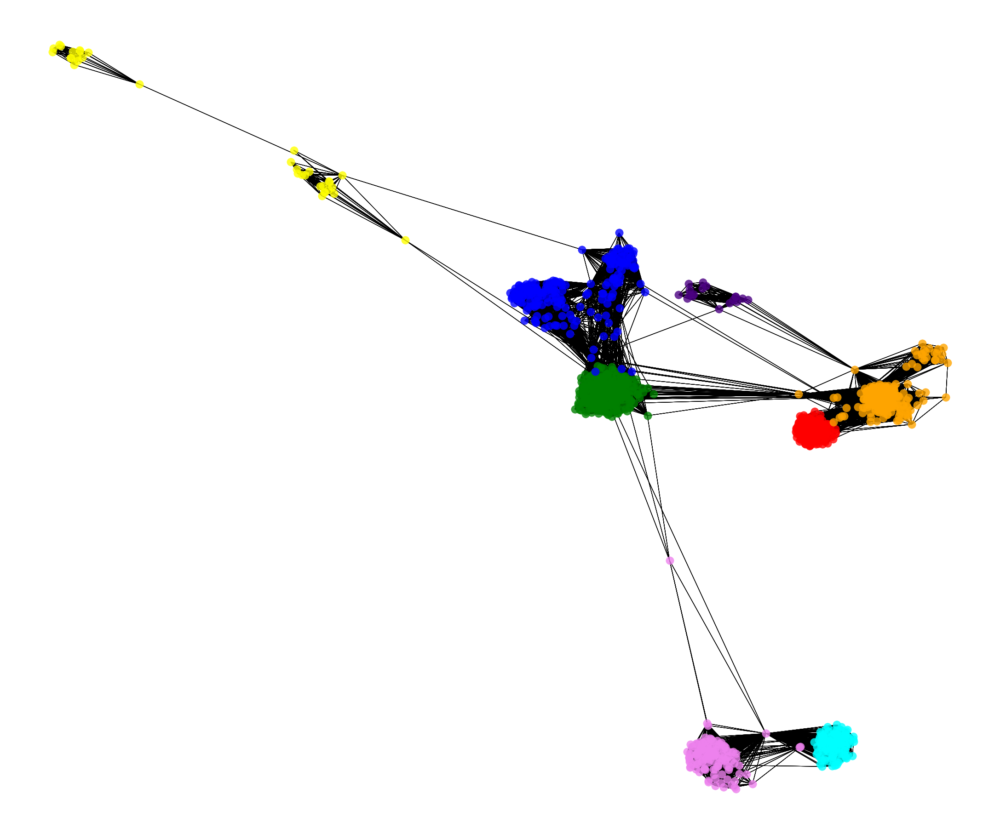

In [60]:
plot_community_subgraph(G_subgraph_fb, greed_list_subfb)

### Community detection based on user '1912' 

###### Let's create a subgraph based on the actor '1912' 

In [61]:
subgraph_1912 = create_subgraph(G_fbsocial, 1912)

In [64]:
print(nx.info(subgraph_1912))

Name: 
Type: Graph
Number of nodes: 1003
Number of edges: 33999
Average degree:  67.7946


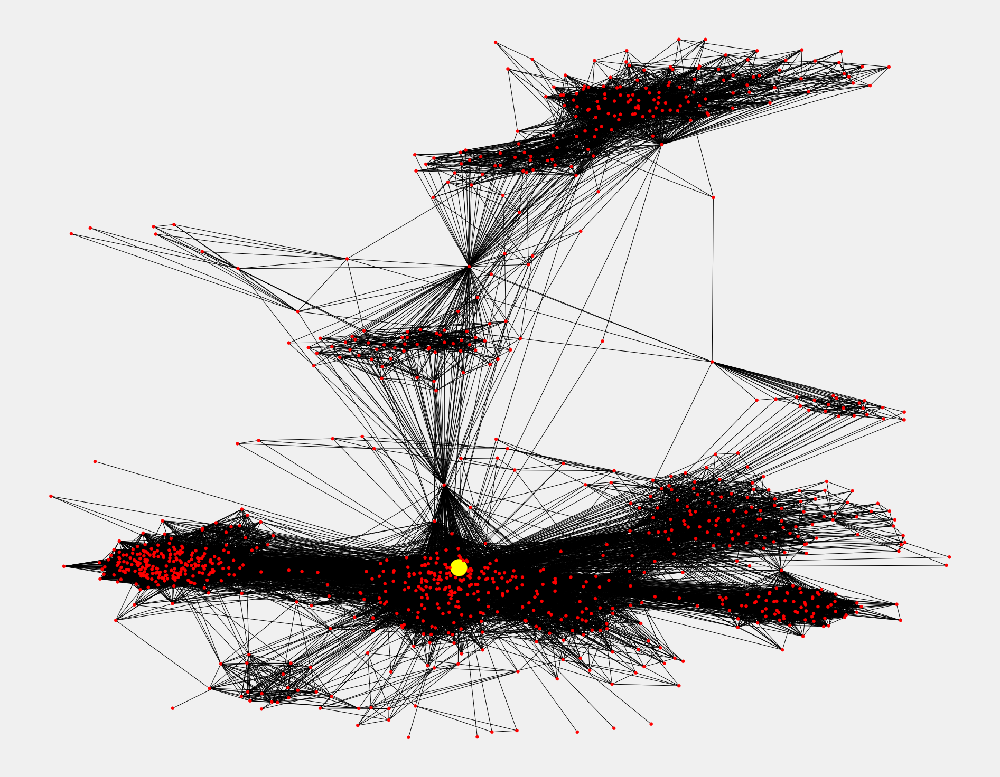

In [65]:
plot_subgraph(subgraph_1912, 1912)

###### Subgraph_1912 Girvan newman

In [52]:
graph_1912, modularity_1912, community_node_groups_1912 = community_node(subgraph_1912, 5)

In [62]:
modularity_1912

[0.0831395407920629,
 0.0006769083994099884,
 0.06833640749522235,
 0.0029895525271120297,
 0.011653182721168016]

In [63]:
print("Modularity:", nx.algorithms.community.modularity(subgraph_1912, community_node_groups_1912))

Modularity: 0.16735215032772868


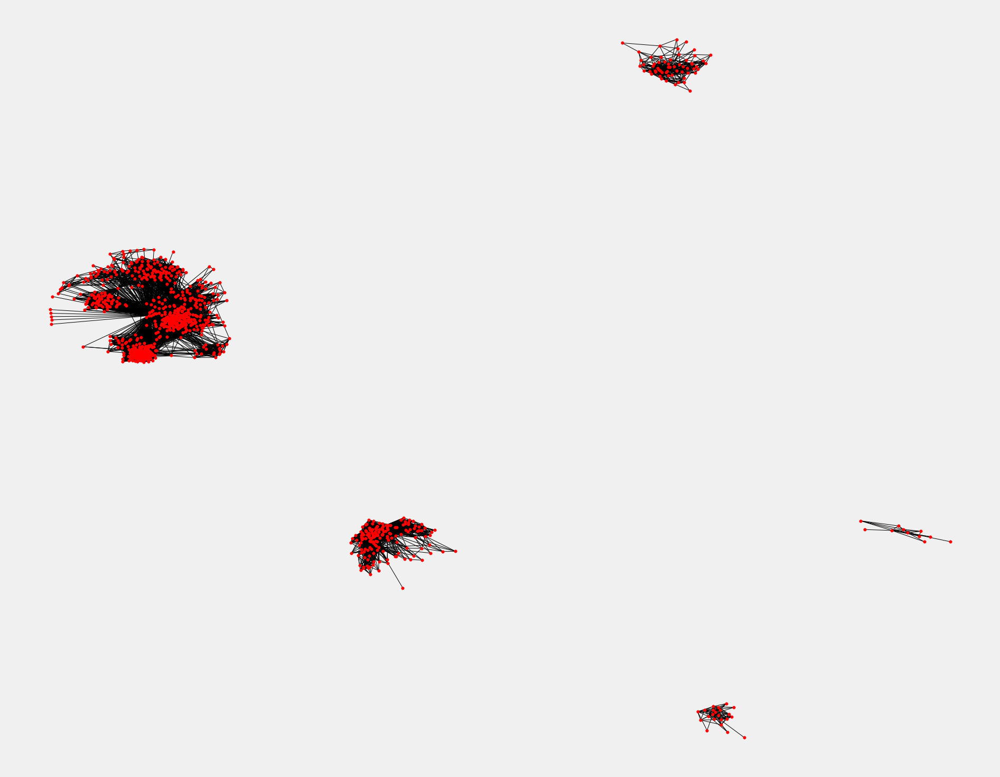

In [66]:
plt_network(graph_1912)

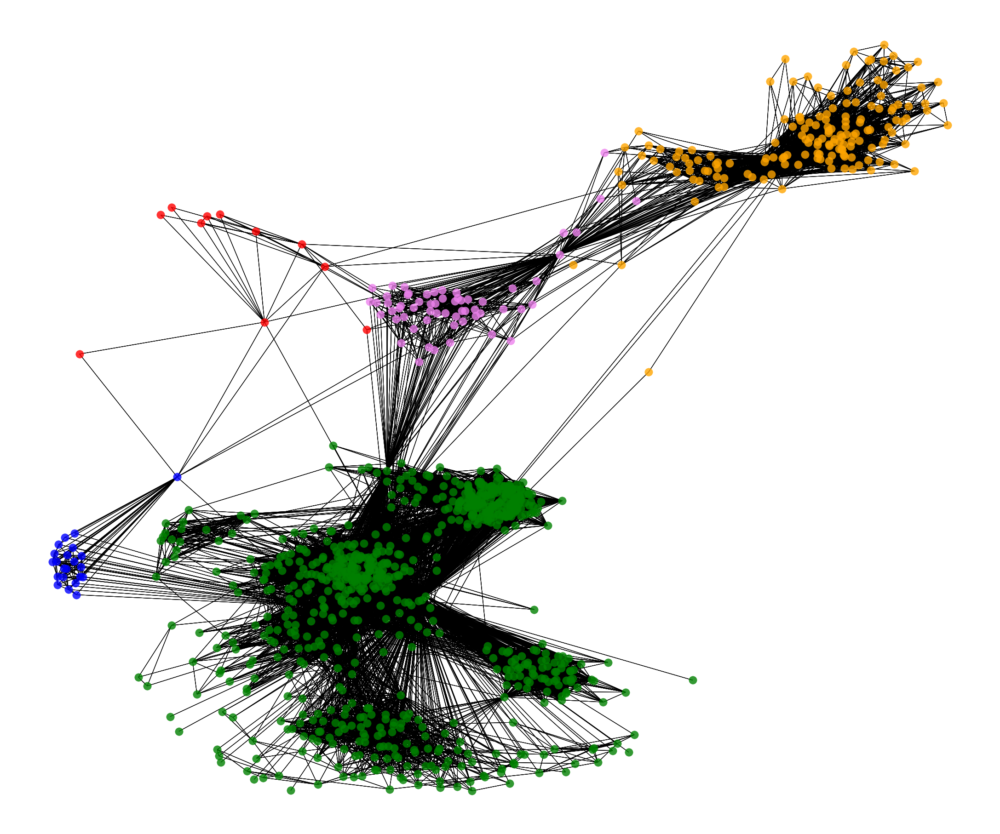

In [67]:
plot_community_subgraph(subgraph_1912, community_node_groups_1912)

###### Subgraph_1912 Greedy modularity

In [68]:
greed_community_1912 = greedy_modularity_communities(subgraph_1912)
greed_list_1912 = list(greed_community_1912)
print("number of communities is", len(list(greed_community_1912)))
print(greed_list_1912)

number of communities is 5
[frozenset({2048, 2052, 2053, 2054, 2057, 2062, 2065, 2066, 2068, 2071, 2072, 2075, 2076, 2079, 2081, 2085, 2087, 2096, 2099, 2101, 2102, 2110, 2111, 2117, 2125, 2127, 2128, 2132, 2133, 2134, 2135, 2137, 2138, 2141, 2143, 2144, 2145, 2148, 2149, 2151, 2153, 2155, 2161, 2163, 2169, 2170, 2174, 2175, 2176, 2177, 2180, 2182, 2183, 136, 2185, 2186, 2187, 2189, 2191, 2194, 2195, 2196, 2198, 2199, 2203, 2205, 2207, 2208, 2209, 2211, 2214, 2215, 2219, 2221, 2222, 2223, 2224, 2226, 2230, 2232, 2235, 2239, 2241, 2242, 2243, 2246, 2247, 2249, 2250, 2252, 2254, 2255, 2256, 2259, 2264, 2265, 2267, 2268, 2269, 2270, 2272, 2273, 2274, 2279, 2280, 2282, 2283, 2285, 2289, 2291, 2292, 2293, 2294, 2295, 2296, 2298, 2302, 2304, 2305, 2310, 2312, 2315, 2318, 2319, 2320, 2322, 2325, 2327, 2328, 2330, 2332, 2333, 2336, 2338, 2343, 2344, 2345, 2347, 2349, 2351, 2355, 2358, 2362, 2366, 2367, 2368, 2372, 2377, 2379, 2384, 2385, 2389, 2390, 2394, 2396, 2398, 2399, 2400, 2401, 2406, 24

In [69]:
print("Modularity:", nx.algorithms.community.modularity(subgraph_1912, greed_list_1912))

Modularity: 0.5855381453359202


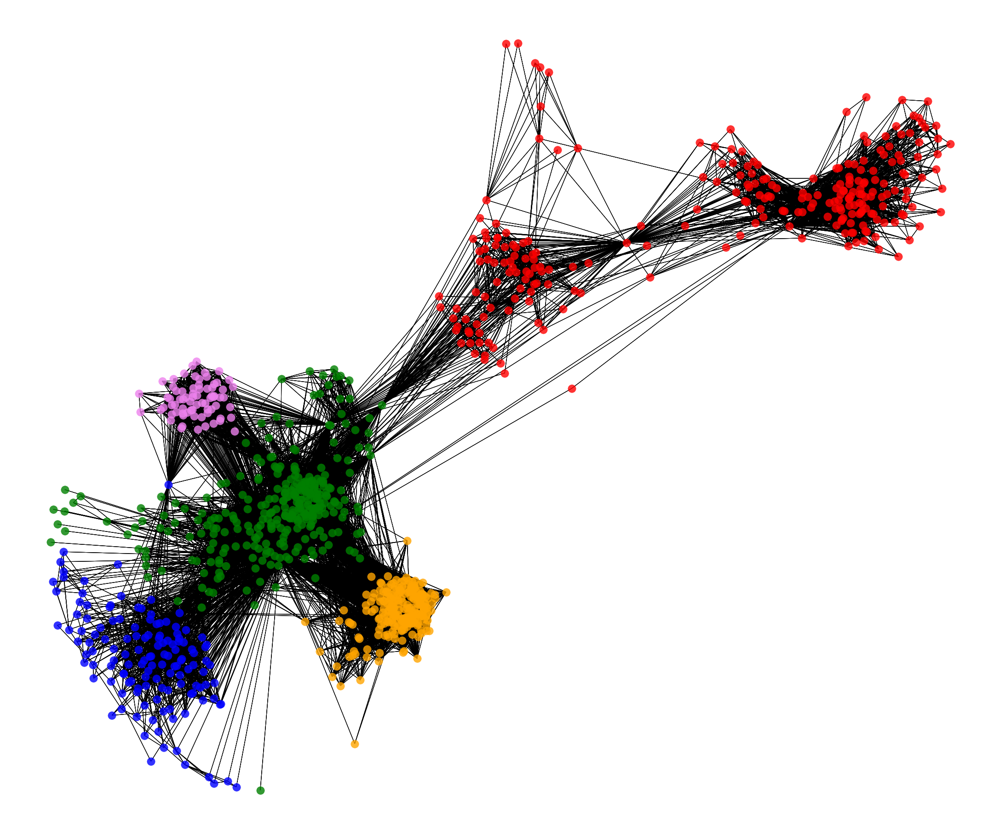

In [70]:
plot_community_subgraph(subgraph_1912, greed_list_1912)

### Community detection based on user '107' 

###### Let's create a subgraph based on the actor '107'

In [71]:
subgraph_107 = create_subgraph(G_fbsocial, 107)

In [72]:
print(nx.info(subgraph_107))

Name: 
Type: Graph
Number of nodes: 2687
Number of edges: 58061
Average degree:  43.2162


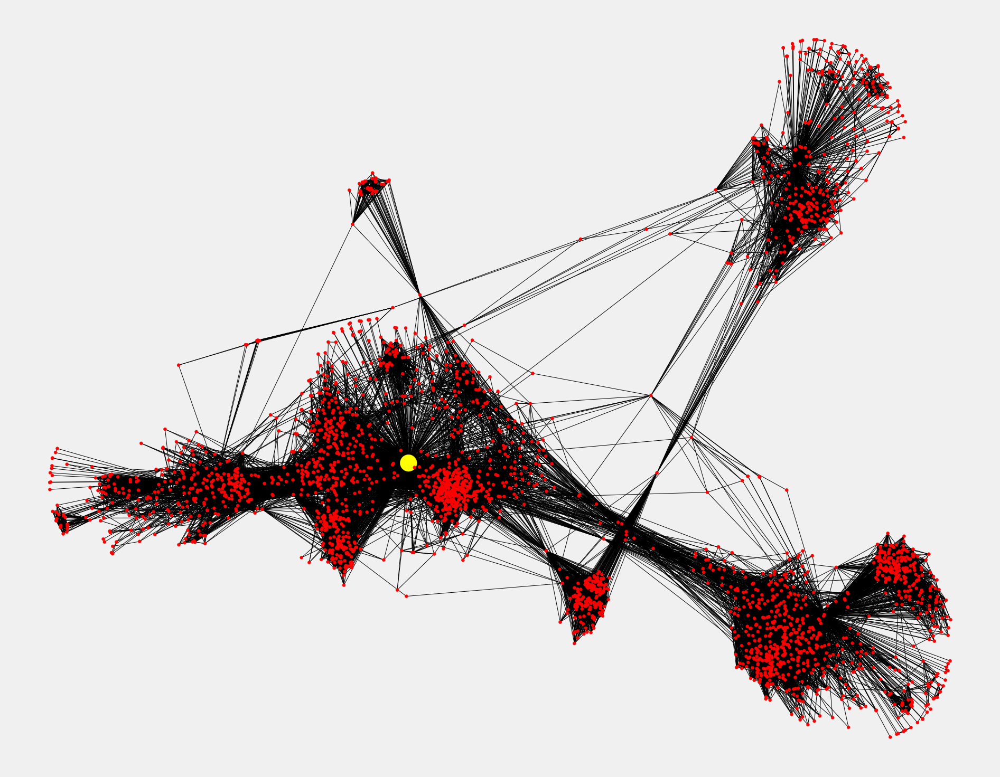

In [73]:
plot_subgraph(subgraph_107, 107)

###### Graph 107 Girvan newman

In [76]:
graph_107, modularity_107, community_node_groups_107 = community_node(subgraph_107, 2)

In [90]:
modularity_107

[0.046162324723618385, 0.04518099614085494]

In [91]:
print("Modularity:", nx.algorithms.community.modularity(subgraph_107, community_node_groups_107))

Modularity: 0.09232464944694044


In [92]:
print(community_node_groups_107)

[[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 167, 168, 169, 170, 172, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 199, 200, 201, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 2

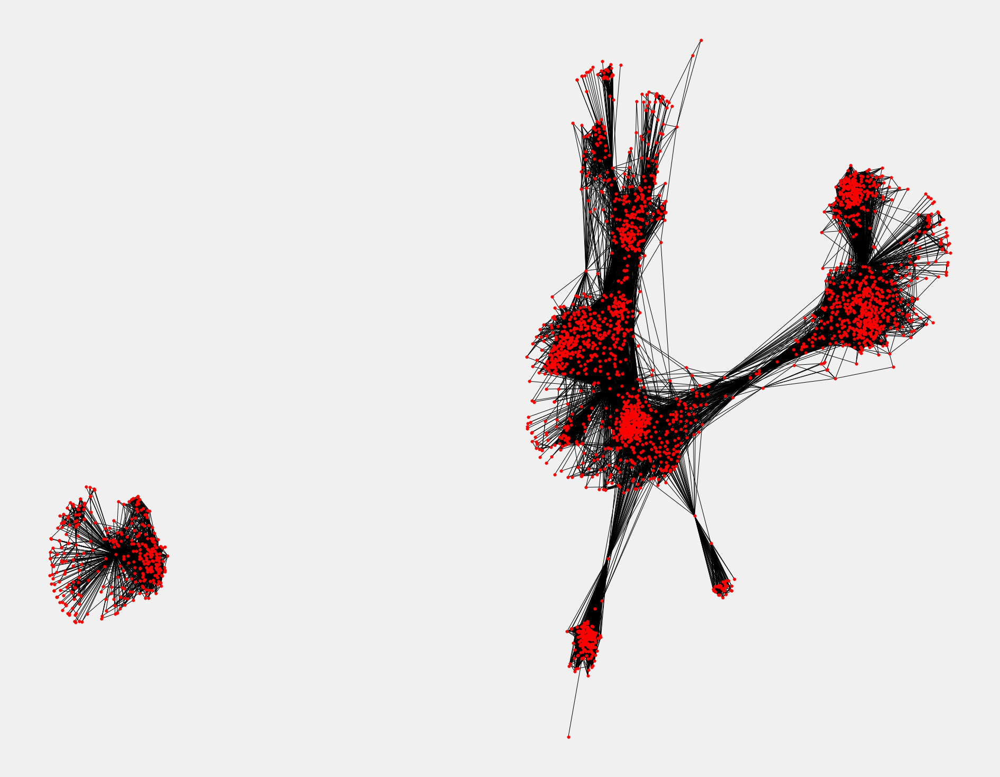

In [93]:
plt_network(graph_107)

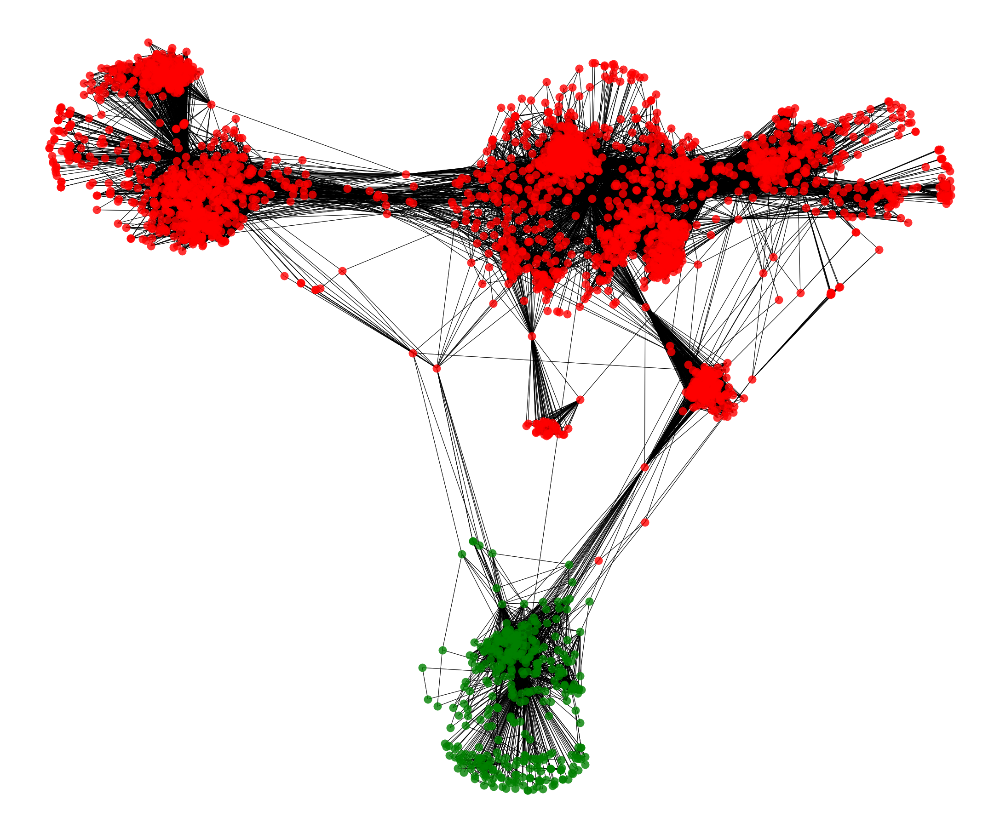

In [94]:
plot_community_subgraph(subgraph_107, community_node_groups_107)

###### Graph_107 Greedy modularity

In [95]:
greed_community_107 = greedy_modularity_communities(subgraph_107)
greed_list_107 = list(greed_community_107)
print("number of communities is", len(list(greed_community_107)))
print(greed_list_107)

number of communities is 11
[frozenset({107, 348, 349, 350, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 394, 395, 396, 397, 398, 400, 401, 402, 403, 404, 405, 406, 407, 408, 409, 410, 411, 412, 413, 414, 415, 416, 417, 418, 419, 420, 421, 422, 423, 424, 425, 426, 428, 429, 430, 431, 432, 433, 434, 435, 436, 437, 438, 439, 440, 442, 443, 444, 445, 446, 447, 448, 449, 450, 451, 452, 453, 455, 456, 457, 458, 459, 460, 461, 462, 463, 465, 466, 467, 468, 469, 470, 471, 472, 473, 474, 475, 477, 478, 479, 480, 481, 482, 483, 484, 485, 486, 487, 488, 489, 490, 491, 492, 493, 494, 495, 496, 497, 498, 499, 500, 502, 503, 504, 505, 506, 507, 508, 509, 510, 511, 512, 513, 514, 515, 516, 517, 518, 519, 520, 521, 522, 523, 524, 525, 526, 527, 528, 529, 530, 531, 532, 533, 534, 535, 536, 537, 538, 539, 540, 541, 542, 543, 544, 545, 546, 547, 548, 

In [96]:
print("Modularity:", nx.algorithms.community.modularity(subgraph_107, greed_list_107))

Modularity: 0.7670019886779921


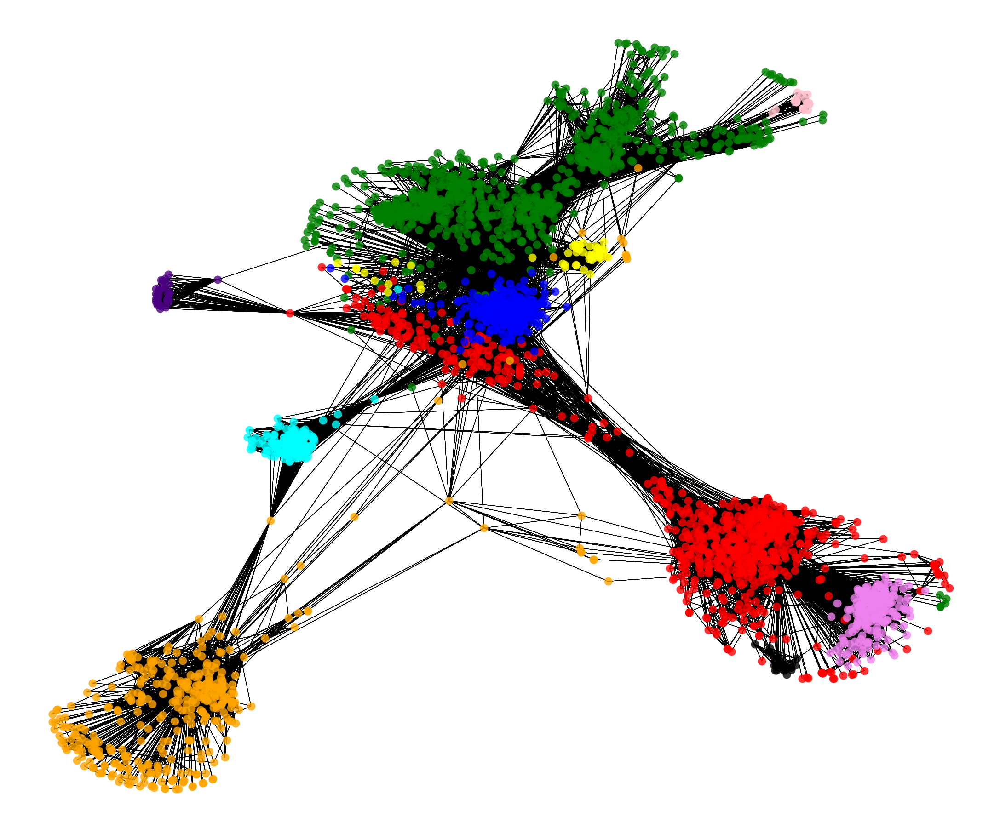

In [97]:
plot_community_subgraph(subgraph_107, greed_list_107)

### Link Prediction

In [104]:
####Let's define the neighbourhood
def CommonNeighbors(u, v, g):
    u_neighbors = set(g.neighbors(u))
    v_neighbors = set(g.neighbors(v))
    return len(u_neighbors.intersection(v_neighbors))
def common_neighbors(g, edges):
    list_neighbours = []
    for edge in edges:
        node_one, node_two = edge[0], edge[1]
        num_common_neighbors = 0
        try:
            neighbors_one, neighbors_two = g.neighbors(node_one), g.neighbors(node_two)
            for neighbor in neighbors_one:
                if neighbor in neighbors_two:
                    num_common_neighbors += 1
            list_neighbours.append((node_one, node_two, num_common_neighbors))
        except:
            pass
    return list_neighbours

In [105]:
####Let's define the feature set
feature_set = [common_neighbors,
                   nx.resource_allocation_index,
                   nx.jaccard_coefficient,
                   nx.adamic_adar_index,
                   nx.preferential_attachment
                   ]

In [106]:
#### Let's create the fakeedges for negative sample
def produce_fake_edge(g, neg_g,num_test_edges):
    i = 0
    while i < num_test_edges:
        edge = random.sample(g.nodes(), 2)
        try:
            shortest_path = nx.shortest_path_length(g,source=edge[0],target=edge[1])
            if shortest_path >= 2:
                neg_g.add_edge(edge[0],edge[1], positive="False")
                i += 1
        except:
            pass

In [107]:
def sample_extraction(g, pos_num, neg_num):
    # randomly select pos_num as test edges
    print("----------------extract positive samples--------------------")
    pos_sample = random.sample(g.edges(), pos_num)
 
    # adding non-existing edges
    print("----------------extract negative samples--------------------")
    neg_g = nx.Graph()
    produce_fake_edge(g,neg_g,neg_num)
    neg_sample = neg_g.edges()
    
    # remove the positive sample edges, the rest is the training set
    g.remove_edges_from(pos_sample)
    
    return pos_sample, neg_sample

In [108]:
def feature_extraction(g, pos_sample, neg_sample, feature_name, model="single", combine_num=2):

    data = []
    label = ["label"] + ["1" for i in range(len(pos_sample))] + ["0" for i in range(len(neg_sample))]
    for j in feature_name:
        print ("-----extract feature:", j.__name__, "----------")
        preds = j(g, pos_sample)

        feature = [j.__name__] + [i[2] for i in preds]
        preds = j(g, neg_sample)
        feature = feature + [i[2] for i in preds]
        data.append(feature)

    data.append(label)
    data = transpose(data)
    print("----------write the features to file---------------")
    write_data_to_file(data, "features_" + model + "_" + str(combine_num) + ".csv")
    
    return data

def write_data_to_file(data, filename):
    csvfile = open(filename, "w")
    writer = csv.writer(csvfile)
    for i in data:
        writer.writerow(i)
    csvfile.close()


def transpose(data):
    return [list(i) for i in zip(*data)]

In [109]:
def link_predict(filename="facebook_combined.txt", pos_num=0.5, neg_num=0.5, model="combined", combine_num=1,
         feature_name=common_neighbors):
    g = nx.read_edgelist(filename, create_using = nx.Graph(), nodetype=int)
    num_edges = g.number_of_edges()
    pos_num = int(num_edges * pos_num)
    neg_num = int(num_edges * neg_num)
    pos_sample, neg_sample = sample_extraction(g, pos_num, neg_num)
    train_data = feature_extraction(g, pos_sample, neg_sample, feature_name, model, combine_num)

In [110]:
link_predict(filename="facebook_combined.txt",model="combined",combine_num=2, feature_name=feature_set)

----------------extract positive samples--------------------
----------------extract negative samples--------------------
-----extract feature: common_neighbors ----------
-----extract feature: resource_allocation_index ----------
-----extract feature: jaccard_coefficient ----------
-----extract feature: adamic_adar_index ----------
-----extract feature: preferential_attachment ----------
----------write the features to file---------------


In [111]:
data_array = np.loadtxt(open("features_combined_2.csv", "rb"), delimiter=",", skiprows=1)
a,b=data_array.shape;
np.random.shuffle(data_array);

In [112]:
train_l=int(0.8*a)
X_train=data_array[0:train_l,0:b-1]
Y_train=data_array[0:train_l,b-1]
X_test=data_array[train_l:a,0:b-1]
Y_test=data_array[train_l:a,b-1]
X_train = normalize(X_train, axis=0, norm='max')
X_test = normalize(X_test, axis=0, norm='max')
scaler = StandardScaler()  
scaler.fit(X_train)  
X_train = scaler.transform(X_train)  
X_test = scaler.transform(X_test)

###### SVM Model

In [113]:
def svm_model(training, training_labels, testing, testing_labels):
    #Support Vector Machine
    clf = svm.SVC()
    clf.fit(training, training_labels)
    result = clf.predict(testing)
    
    print("SVM accuracy:", accuracy_score(testing_labels, result))
    print("SVM F1 Score:", f1_score(result, testing_labels,average='macro'))

In [114]:
svm_model(X_train,Y_train,X_test,Y_test)

SVM accuracy: 0.9572198581560284
SVM F1 Score: 0.9572196035178815


###### Logistic regression model

In [115]:
def logistic_model(training, training_labels, testing, testing_labels):
    clf = LogisticRegression(random_state=0, solver='lbfgs',multi_class='ovr').fit(training, training_labels)
    clf.fit(training, training_labels)
    result=clf.predict(testing)
    
    print ("Logistic regression accuracy:", accuracy_score(testing_labels, result)) 
    print("Logistic regression F1 Score:", f1_score(result, testing_labels,average='macro'))

In [116]:
logistic_model(X_train,Y_train,X_test,Y_test)

Logistic regression accuracy: 0.9553475177304964
Logistic regression F1 Score: 0.9553421071553178
